# Final Plots
#### In order to make the navigation easier, the 3 final plots will be displayed right below. The logic to get to them, is described in the following headings.

## P1(Bar-chart): Analyzing Larceny and Theft Incidents: Arrest Resolutions and PdDistrict Breakdown.
We decided to conduct a detailed analysis of Larceny and Theft incidents, as they are the most common crimes, accounting for 22.5% of all reported crimes. Additionally, the most frequent resolution for these crimes is through arrests. To analyze these incidents, we filtered out the ones with a resolution of "NONE" and focused on those with descriptions such as 'ARREST, BOOKED' or 'ARREST, CITED'. We also created a breakdown by PdDistrict to determine which districts are performing better in addressing these crimes.

Upon analyzing the data, we noticed that the proportions of Larceny and Theft incidents have remained relatively stable over time. This leads us to believe that the police department's efforts to address these crimes have not significantly impacted the overall incidence of these crimes.

/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:11: Settin

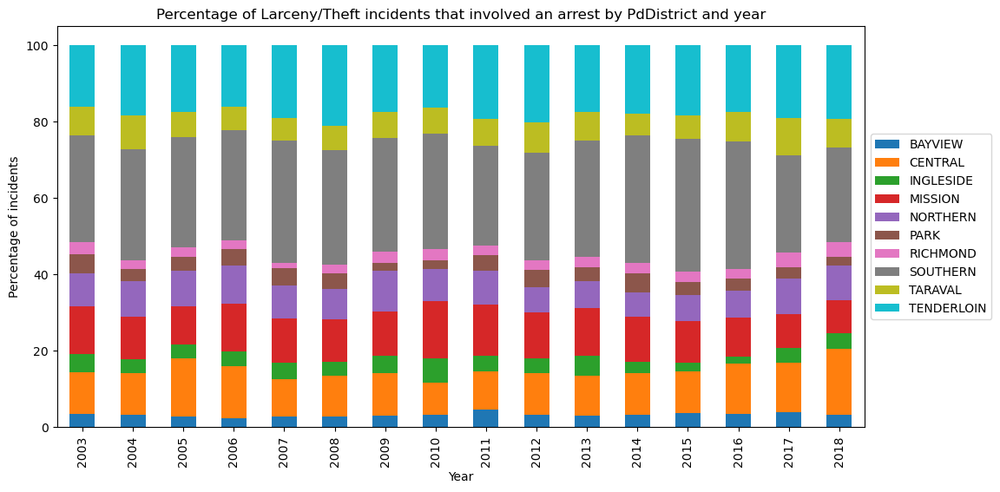

In [ ]:
# Filter the dataframe to only include incidents in the 'Larceny/Theft' category with resolution of 'NONE'
larceny_theft_arrest_df = df_crimes[(df_crimes['Category'] == 'LARCENY/THEFT') & (df_crimes['Resolution'] != 'NONE') & (df_crimes['Descript'].str.contains('ARREST'))]

# Convert the 'Date' column to a datetime data type
larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')

# Create a new column called 'Year' by extracting the year from the 'Date' column
larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year

# Create a new column called 'PdDistrict'
larceny_theft_none_df['PdDistrict'] = larceny_theft_none_df['PdDistrict'].fillna('Unknown')

# Group the data by year and PdDistrict, and count the number of incidents in each group
yearly_pd_counts = larceny_theft_none_df.groupby(['Year', 'PdDistrict']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, PdDistricts as columns, and incident counts as values
yearly_pd_pivot = yearly_pd_counts.pivot(index='Year', columns='PdDistrict', values='TotalIncidents').fillna(0)

# Create a percentage version of the pivot table
yearly_pd_pct = yearly_pd_pivot.apply(lambda x: x/x.sum()*100, axis=1)

# Plot a yearly stacked bar chart with a PdDistrict breakdown
yearly_pd_pct.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Percentage of incidents')
plt.title('Percentage of Larceny/Theft incidents that involved an arrest by PdDistrict and year')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

## P2(Map-plot): 2017 to May 2018 Map plot 
In conclusion, by utilizing the map, and analyzing the concentration of crime in different police districts, we have obtained valuable insights that can help identify patterns and trends in the data. This can aid in making recommendations to improve public safety in San Francisco and enable the Police to gain a better understanding of crime trends in the city.


In [15]:
# Display the map
SF_map

# Plot Logic Descripotions

## Plot 1. One time-series / bar chart

### EDA

#### Percentage of each crime
We can see the LARCENY/THEFT are the most prevalent crimes corresponding to 22.5 %

In [ ]:
# Group the data by category and count the number of incidents in each group
category_counts = df_crimes.groupby('Category').size().reset_index(name='TotalIncidents')

# Calculate the total number of incidents in the dataset
total_incidents = category_counts['TotalIncidents'].sum()

# Calculate the percentage of incidents for each category
category_counts['Percentage'] = category_counts['TotalIncidents'] / total_incidents * 100

# Sort the data by percentage in descending order
category_counts = category_counts.sort_values('Percentage', ascending=False)

# Print the results
category_counts[['Category', 'Percentage']].head(5)

,Category,Percentage
15,LARCENY/THEFT,22.445146
20,OTHER OFFENSES,14.175649
19,NON-CRIMINAL,11.125861
1,ASSAULT,7.844097
34,VEHICLE THEFT,5.927519


#### Percentage of each Crime Description
We can see the most common crime description is Theft from locked auto. 

In [ ]:
# Group the data by description and count the number of incidents in each group
description_counts = df_crimes.groupby('Descript').size().reset_index(name='TotalIncidents')

# Calculate the total number of incidents in the dataset
total_incidents = description_counts['TotalIncidents'].sum()

# Calculate the percentage of incidents for each description
description_counts['Percentage'] = description_counts['TotalIncidents'] / total_incidents * 100

# Sort the data by percentage in descending order
description_counts = description_counts.sort_values('Percentage', ascending=False)

# Print the results
description_counts[['Descript', 'Percentage']].head(5)

,Descript,Percentage
388,GRAND THEFT FROM LOCKED AUTO,8.395112
455,LOST PROPERTY,3.660300
134,BATTERY,3.114356
707,STOLEN AUTOMOBILE,3.034292
271,"DRIVERS LICENSE, SUSPENDED OR REVOKED",2.928916


#### Analyzing the "Larceny/Theft" category and its resolution (with groupping) over time.

This stacked bar chart displays the number of Larceny/Theft incidents in San Francisco over time, grouped by broad resolution categories. The categories include Arrest (combining Arrest, Booked and Arrest, Cited), Prosecuted (combining Prosecuted by Outside Agency and Prosecuted for Lesser Offense), and other categories. The chart highlights the trends in the grouped resolution categories of Larceny/Theft incidents in San Francisco over the past two decades.

/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/2417279133.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_df['Date'] = pd.to_datetime(larceny_theft_df['Date'], format='%m/%d/%Y')
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/2417279133.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_df['Year'] = larceny_theft_df['Date'].dt.year
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/2417279133.py:11: SettingWithCopyWarning: 
A

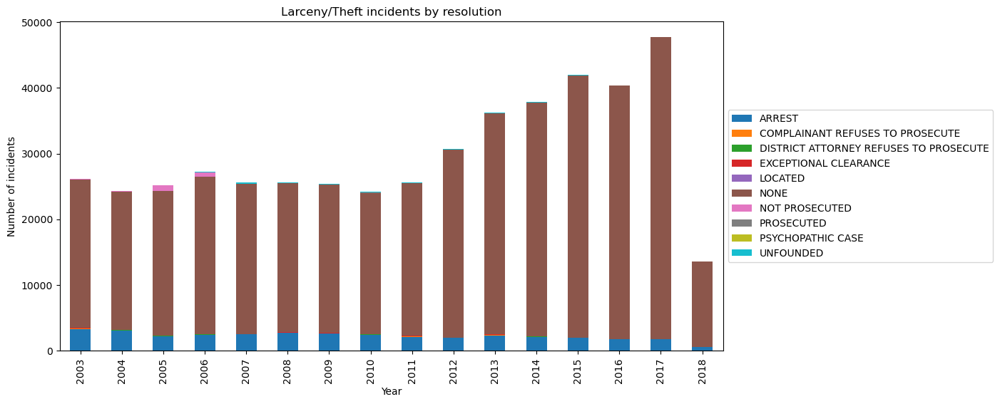

In [ ]:
# Filter the dataframe to only include incidents in the 'Larceny/Theft' category
larceny_theft_df = df_crimes[df_crimes['Category'] == 'LARCENY/THEFT']

# Convert the 'Date' column to a datetime data type
larceny_theft_df['Date'] = pd.to_datetime(larceny_theft_df['Date'], format='%m/%d/%Y')

# Create a new column called 'Year' by extracting the year from the 'Date' column
larceny_theft_df['Year'] = larceny_theft_df['Date'].dt.year

# Create a new column called 'Month' by extracting the month from the 'Date' column
larceny_theft_df['Month'] = larceny_theft_df['Date'].dt.month_name()

# Map sub-categories to broader categories
resolution_map = {
    'ARREST, BOOKED': 'ARREST',
    'ARREST, CITED': 'ARREST',
    'PROSECUTED BY OUTSIDE AGENCY': 'PROSECUTED',
    'PROSECUTED FOR LESSER OFFENSE': 'PROSECUTED'
}
larceny_theft_df['Resolution'] = larceny_theft_df['Resolution'].map(resolution_map).fillna(larceny_theft_df['Resolution'])

# Group the data by year and resolution, and count the number of incidents in each group
yearly_resolutions = larceny_theft_df.groupby(['Year', 'Resolution']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, resolutions as columns, and incident counts as values
yearly_resolutions_pivot = yearly_resolutions.pivot(index='Year', columns='Resolution', values='TotalIncidents').fillna(0)

# Plot a stacked bar chart showing the number of incidents for each resolution over time
yearly_resolutions_pivot.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Number of incidents')
plt.title('Larceny/Theft incidents by resolution')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()



##### Percentage by resolution
The majority of the cases have None as the Resolution

In [ ]:
larceny_theft_df['Resolution'] = larceny_theft_df['Resolution'].map(resolution_map).fillna(larceny_theft_df['Resolution'])

# Group the data by resolution and count the number of incidents in each group
resolution_counts = larceny_theft_df.groupby('Resolution').size().reset_index(name='TotalIncidents')

# Calculate the total number of incidents in the "Larceny/Theft" category
total_incidents = resolution_counts['TotalIncidents'].sum()

# Calculate the percentage of incidents for each resolution
resolution_counts['Percentage'] = resolution_counts['TotalIncidents'] / total_incidents * 100

# Sort the data by percentage in descending order
resolution_counts = resolution_counts.sort_values('Percentage', ascending=False)

# Print the results
print(resolution_counts[['Resolution', 'Percentage']])

                               Resolution  Percentage
5                                    NONE   91.621319
0                                  ARREST    7.447879
6                          NOT PROSECUTED    0.334746
9                               UNFOUNDED    0.255453
1        COMPLAINANT REFUSES TO PROSECUTE    0.098541
2  DISTRICT ATTORNEY REFUSES TO PROSECUTE    0.097704
3                   EXCEPTIONAL CLEARANCE    0.092473
7                              PROSECUTED    0.032847
8                       PSYCHOPATHIC CASE    0.009833
4                                 LOCATED    0.009206


/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/403120406.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_df['Resolution'] = larceny_theft_df['Resolution'].map(resolution_map).fillna(larceny_theft_df['Resolution'])


##### Percentage of each Description

In [ ]:
# Group the data by sub-category and count the number of incidents in each group
subcategory_counts = larceny_theft_df.groupby('Descript').size().reset_index(name='TotalIncidents')

# Calculate the total number of incidents in the "Larceny/Theft" category
total_incidents = subcategory_counts['TotalIncidents'].sum()

# Calculate the percentage of incidents for each sub-category
subcategory_counts['Percentage'] = subcategory_counts['TotalIncidents'] / total_incidents * 100

# Sort the data by percentage in descending order
subcategory_counts = subcategory_counts.sort_values('Percentage', ascending=False)

# Print the results
subcategory_counts[['Descript', 'Percentage']]


,Descript,Percentage
19,GRAND THEFT FROM LOCKED AUTO,37.402793
36,PETTY THEFT FROM LOCKED AUTO,10.860819
39,PETTY THEFT OF PROPERTY,9.634186
23,GRAND THEFT OF PROPERTY,6.150949
35,PETTY THEFT FROM A BUILDING,5.360741
...,...,...
58,"THEFT, DRUNK ROLL, ATT.",0.000837
59,"THEFT, GRAND, AGRICULTURAL",0.000837
29,LOOTING DURING STATE OF EMERGENCY,0.000837
12,ATTEMPTED THEFT PHONE BOOTH,0.000628


#### Filter our the None Category
Here we filter out the None Category so we can visualize better the data

/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/2167141799.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_df['Resolution'] = larceny_theft_df['Resolution'].map(resolution_map).fillna(larceny_theft_df['Resolution'])


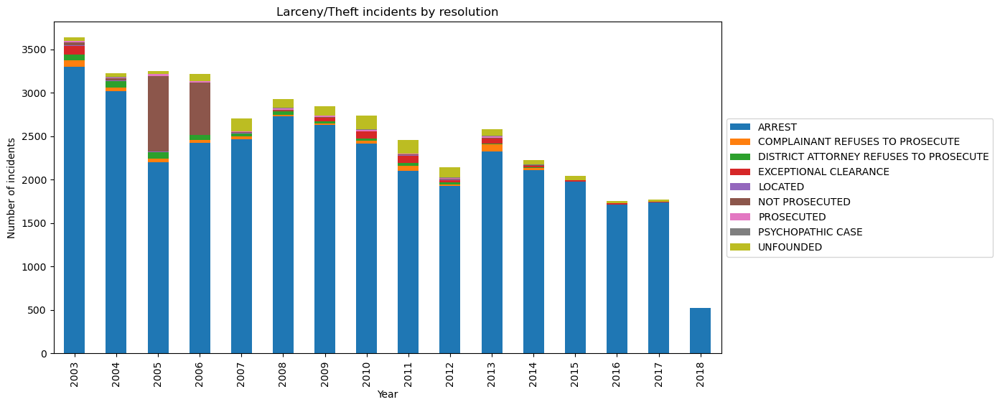

In [ ]:
larceny_theft_df['Resolution'] = larceny_theft_df['Resolution'].map(resolution_map).fillna(larceny_theft_df['Resolution'])

# Filter out the 'NONE' sub-category
larceny_theft_df = larceny_theft_df[larceny_theft_df['Resolution'] != 'NONE']

# Group the data by year and resolution, and count the number of incidents in each group
yearly_resolutions = larceny_theft_df.groupby(['Year', 'Resolution']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, resolutions as columns, and incident counts as values
yearly_resolutions_pivot = yearly_resolutions.pivot(index='Year', columns='Resolution', values='TotalIncidents').fillna(0)

# Plot a stacked bar chart showing the number of incidents for each resolution over time
yearly_resolutions_pivot.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Number of incidents')
plt.title('Larceny/Theft incidents by resolution')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

### Larceny/Theft incidents with resolution of NONE by PdDistrict and year.

/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3597877542.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3597877542.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3597877542.py:11: Settin

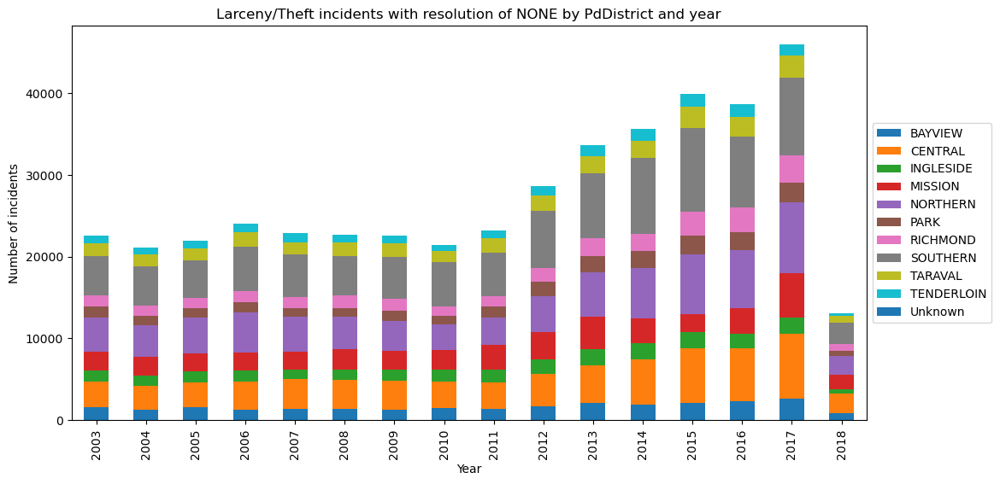

In [ ]:
# Filter the dataframe to only include incidents in the 'Larceny/Theft' category with resolution of 'NONE'
larceny_theft_none_df = df_crimes[(df_crimes['Category'] == 'LARCENY/THEFT') & (df_crimes['Resolution'] == 'NONE')]

# Convert the 'Date' column to a datetime data type
larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')

# Create a new column called 'Year' by extracting the year from the 'Date' column
larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year

# Create a new column called 'PdDistrict'
larceny_theft_none_df['PdDistrict'] = larceny_theft_none_df['PdDistrict'].fillna('Unknown')

# Group the data by year and PdDistrict, and count the number of incidents in each group
yearly_pd_counts = larceny_theft_none_df.groupby(['Year', 'PdDistrict']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, PdDistricts as columns, and incident counts as values
yearly_pd_pivot = yearly_pd_counts.pivot(index='Year', columns='PdDistrict', values='TotalIncidents').fillna(0)

# Plot a yearly bar chart with a PdDistrict breakdown
yearly_pd_pivot.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Number of incidents')
plt.title('Larceny/Theft incidents with resolution of NONE by PdDistrict and year')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3700572689.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3700572689.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/3700572689.py:11: Settin

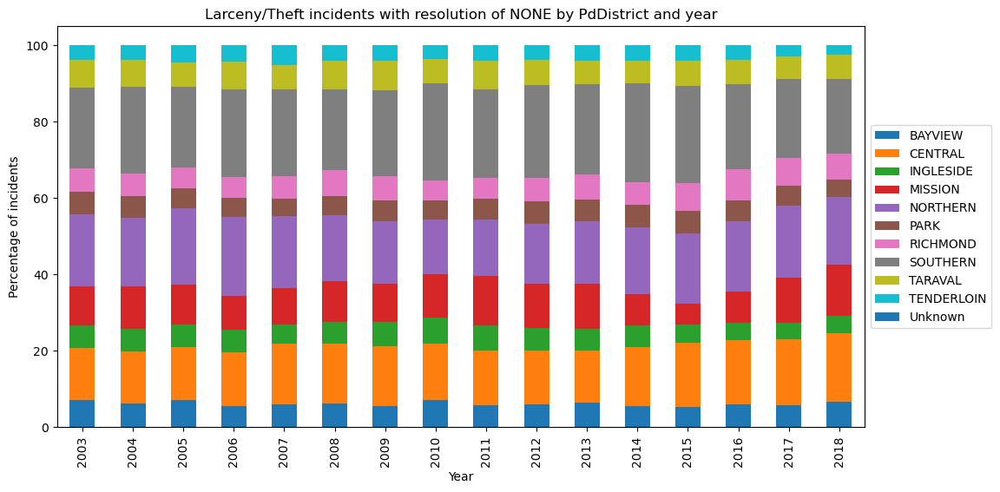

In [ ]:
# Filter the dataframe to only include incidents in the 'Larceny/Theft' category with resolution of 'NONE'
larceny_theft_none_df = df_crimes[(df_crimes['Category'] == 'LARCENY/THEFT') & (df_crimes['Resolution'] == 'NONE')]

# Convert the 'Date' column to a datetime data type
larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')

# Create a new column called 'Year' by extracting the year from the 'Date' column
larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year

# Create a new column called 'PdDistrict'
larceny_theft_none_df['PdDistrict'] = larceny_theft_none_df['PdDistrict'].fillna('Unknown')

# Group the data by year and PdDistrict, and count the number of incidents in each group
yearly_pd_counts = larceny_theft_none_df.groupby(['Year', 'PdDistrict']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, PdDistricts as columns, and incident counts as values
yearly_pd_pivot = yearly_pd_counts.pivot(index='Year', columns='PdDistrict', values='TotalIncidents').fillna(0)

# Convert the counts to percentages
yearly_pd_pivot_percent = yearly_pd_pivot.apply(lambda x: x/x.sum(), axis=1)*100

# Plot a percentage stacked bar chart with a PdDistrict breakdown
yearly_pd_pivot_percent.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Percentage of incidents')
plt.title('Larceny/Theft incidents with resolution of NONE by PdDistrict and year')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()


/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year
/var/folders/44/wvtg39xd19vdrx40g1phtyq80000gn/T/ipykernel_21078/1870507638.py:11: Settin

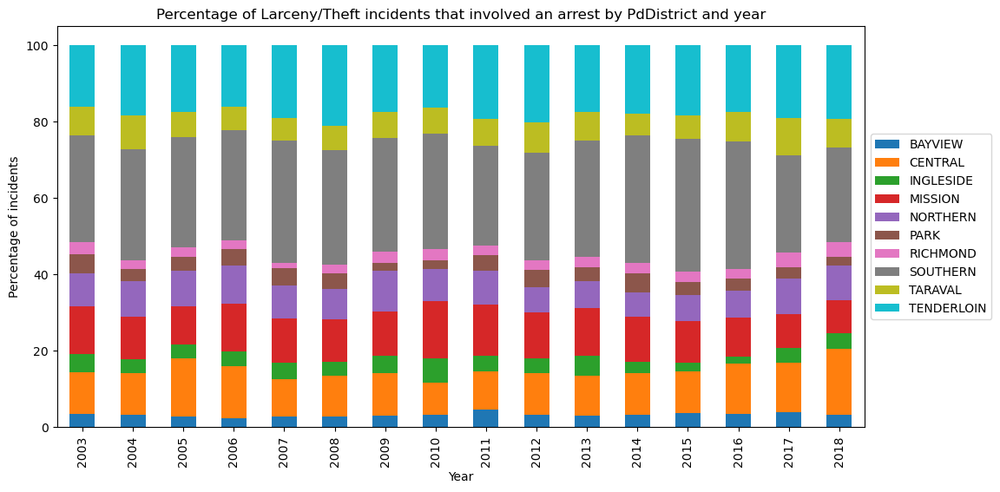

In [ ]:
# Filter the dataframe to only include incidents in the 'Larceny/Theft' category with resolution of 'NONE'
larceny_theft_arrest_df = df_crimes[(df_crimes['Category'] == 'LARCENY/THEFT') & (df_crimes['Resolution'] != 'NONE') & (df_crimes['Descript'].str.contains('ARREST'))]

# Convert the 'Date' column to a datetime data type
larceny_theft_none_df['Date'] = pd.to_datetime(larceny_theft_none_df['Date'], format='%m/%d/%Y')

# Create a new column called 'Year' by extracting the year from the 'Date' column
larceny_theft_none_df['Year'] = larceny_theft_none_df['Date'].dt.year

# Create a new column called 'PdDistrict'
larceny_theft_none_df['PdDistrict'] = larceny_theft_none_df['PdDistrict'].fillna('Unknown')

# Group the data by year and PdDistrict, and count the number of incidents in each group
yearly_pd_counts = larceny_theft_none_df.groupby(['Year', 'PdDistrict']).size().reset_index(name='TotalIncidents')

# Pivot the data to create a matrix with years as rows, PdDistricts as columns, and incident counts as values
yearly_pd_pivot = yearly_pd_counts.pivot(index='Year', columns='PdDistrict', values='TotalIncidents').fillna(0)

# Create a percentage version of the pivot table
yearly_pd_pct = yearly_pd_pivot.apply(lambda x: x/x.sum()*100, axis=1)

# Plot a yearly stacked bar chart with a PdDistrict breakdown
yearly_pd_pct.plot(kind='bar', stacked=True, figsize=(12,6))
plt.xlabel('Year')
plt.ylabel('Percentage of incidents')
plt.title('Percentage of Larceny/Theft incidents that involved an arrest by PdDistrict and year')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

## Plot2: Map Plot May 2017 - May 2018 Data

In this part we will analyz crime data from May 2017 to May 2018, specifically focusing on larceny and theft incidents.

First, we imported the necessary libraries, including Folium and Pandas. Folium is a Python library that allows us to create interactive maps, and Pandas is a data manipulation library.

In [1]:
# Import the necessary libraries
import folium
import pandas as pd
from folium.plugins import HeatMapWithTime

Next, we importe the crime dataset into the Jupyter Notebook using Pandas. We also parse the date and time columns to create a single datetime column for easier data analysis.

In [2]:
# Import the dataset
df = pd.read_csv('data/Police_Department_Incident_Reports__Historical_2003_to_May_2018.csv', parse_dates=[['Date', 'Time']])

In [5]:
# Filter the dataset to only include larceny and theft incidents between May 2017 and May 2018.
df_larceny_theft = df.loc[(df['Date_Time'] >= "2017-05-31") &
(df['Date_Time'] < "2018-05-31") &
(df['Category'] == "LARCENY/THEFT")].reset_index(drop=True)

In [6]:
# Create a list of latitude and longitude pairs for each incident
x_y = [(lat, lon) for lat, lon in zip(df_larceny_theft["Y"], df_larceny_theft["X"])]

We create a map of San Francisco using Folium. We set the map's initial coordinates and zoom level and chose the "Stamen Toner" tileset for the map's visual style.
To plot the crime incidents on the map, we loop through the dataset and create a circle marker for each crime incident. We set the marker's color to red and radius to 1 to distinguish them from each other. We add the markers to the map, creating an interactive visualization of the crime incidents in San Francisco.

In [8]:
# Plot the locations on a map
SF_map = folium.Map(location=[37.77919, -122.41914], zoom_start=12, tiles="Stamen Toner")
folium.Marker(location=[37.77919, -122.41914], popup='SF City Hall').add_to(SF_map)

for location in x_y:
    folium.CircleMarker(location=location, radius=1, color='red').add_to(SF_map)

SF_map

In [9]:
# Create a column in the dataset that indicated the week number for each incident.
df_larceny_theft["week number"] = df_larceny_theft["Date_Time"].dt.week

/var/folders/cb/p8cff5793nq7ln19w8dps3cr0000gn/T/ipykernel_1118/778236016.py:2: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df_larceny_theft["week number"] = df_larceny_theft["Date_Time"].dt.week


In [10]:
# Group the incidents by week number and count the number of larceny and theft incidents per week.
larceny_theft_pr_week = df_larceny_theft.groupby(by=["week number"]).size().reset_index(name="larceny/theft pr. week")

Using the latitude and longitude data from the filtered dataset, we create a heatmap for each week showing the density of larceny and theft incidents in each location.

In [11]:
# Create a list of (latitude, longitude) pairs for each week
heatmap = []
for i in range(1, 19):
    heatmap_1 = []
    
    for _, row in df_larceny_theft[df_larceny_theft["week number"] == i].iterrows():
        lat_lon = [row["Y"], row["X"]]
        heatmap_1.append(lat_lon)
    
    heatmap.append(heatmap_1)

We add the heatmap to the Folium map we had created earlier.

In [12]:
# Create a map and add the heat map
SF_map = folium.Map(location=[37.77919, -122.41914], zoom_start=12, tiles="Stamen Toner")
HeatMapWithTime(heatmap, auto_play=True, max_opacity=0.7).add_to(SF_map)

SF_map

Lastly, we add markers to the map for each police district in San Francisco, using the mean latitude and longitude of the incidents in each district. We includ a popup for each marker displaying the district name and the number of crimes committed in that district during the given time frame.

In [13]:
district_counts = df["PdDistrict"].value_counts()

# Add a marker for each police district
for district in district_counts.index:
    # Get the latitude and longitude of the district
    district_data = df[df["PdDistrict"] == district]
    latitude = district_data["Y"].mean()
    longitude = district_data["X"].mean()
    
    # Add a marker for the district
    folium.Marker(
        location=[latitude, longitude],
        popup=f"{district}: {district_counts[district]} crimes",
        icon=folium.Icon(color="purple", icon="info-sign")
    ).add_to(SF_map)

In [14]:
# Display the map
SF_map

In conclusion, by utilizing the map, and analyzing the concentration of crime in different police districts, we have obtained valuable insights that can help identify patterns and trends in the data. This can aid in making recommendations to improve public safety in San Francisco and enable the Police to gain a better understanding of crime trends in the city.

## Part 3: interactive visualization in Bokeh

The dataset used for this analysis is the San Francisco Crime Data from May 2017 to May 2018. The goal of this data story is to analyze the patterns of larceny and theft incidents in the city and identify any trends or changes over time.

The first visualization is a time-series bar chart showing the monthly counts of larceny and theft incidents. The chart reveals a clear pattern of seasonality, with higher counts during the summer months and lower counts during the winter months. The highest counts of incidents occurred in August and September, while the lowest counts occurred in December and January. Overall, the chart shows that larceny and theft incidents were more common during the warmer months of the year.

first we need to import the necessary libraries

In [3]:
import pandas as pd
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, HoverTool, Select
from bokeh.layouts import column
from bokeh.io import curdoc

In [17]:
df = pd.read_csv('data/Police_Department_Incident_Reports__Historical_2003_to_May_2018.csv', parse_dates=['Date', 'Time'],low_memory=False)

Filter data to May 2017 to May 2018 and larceny and theft incidents

In [18]:
df = df[(df['Date'] >= '2017-05-01') & (df['Date'] <= '2018-05-31') & ((df['Category'] == 'LARCENY/THEFT'))]

Group data by month and count incidents

In [19]:
monthly_counts = df.groupby(pd.Grouper(key='Date', freq='M'))['Category'].count()

### Create a ColumnDataSource for the plot

In [20]:
source = ColumnDataSource(data=dict(x=monthly_counts.index.values, y=monthly_counts.values))

# Create the figure
p = figure(title='Monthly Larceny/Theft Incidents in San Francisco (May 2017 - May 2018)',
           x_axis_label='Month', y_axis_label='Incidents', x_axis_type='datetime',
           plot_width=800, plot_height=400)

# Add a line to the plot
line = p.line(x='x', y='y', source=source, line_width=2, line_color='blue')

# Add a hover tool to show incident count on hover
hover = HoverTool(tooltips=[('Incidents', '@y')], mode='vline')
p.add_tools(hover)

Add a select widget to allow users to switch between line and bar charts

In [22]:
select = Select(title='Select Chart Type:', options=['Line', 'Bar'], value='Line')
def update_chart(attrname, old, new):
    if new == 'Line':
        line.visible = True
        bar.visible = False
    else:
        line.visible = False
        bar.visible = True
select.on_change('value', update_chart)

# Create a bar chart
bar_source = ColumnDataSource(data=dict(x=monthly_counts.index.values, top=monthly_counts.values))
bar = figure(title='Monthly Larceny/Theft Incidents in San Francisco (May 2017 - May 2018)',
             x_axis_label='Month', y_axis_label='Incidents', x_axis_type='datetime',
             plot_width=800, plot_height=400, visible=False)

### Combine line and bar charts into a single layout and show the layout

In [23]:
layout = column(select, column(p, bar))

# Show the plot
curdoc().add_root(layout)
show(p)

In conclusion, the analysis of the San Francisco Crime Data from May 2017 to May 2018 reveals some interesting patterns and trends in larceny and theft incidents. The data suggests that these types of incidents are more common during the summer months, particularly in the downtown and tourist areas of the city. The interactive scatter plot also shows some interesting patterns in the day of the week and time of day of incidents, which may be useful for crime prevention efforts.

### the exercise we did for Week 6

In [ ]:
import pandas as pd 
df = pd.read_csv("data/Police_Department_Incident_Reports__Historical_2003_to_May_2018.csv",low_memory=False)
df['Date'] = pd.to_datetime(df['Date'])
# slice the dataframe to get data between 2010 and 2017
df = df[(df['Date'].dt.year >= 2010) & (df['Date'].dt.year <= 2017)]
focuscrimes = set(['LARCENY/THEFT'])
df = df[df['Category'].isin(focuscrimes)]
df['HourOfDay'] = df['Time'].str.strip().str[0:2]
# Define a figure with title and axis labels
p = figure(x_range=source.data['HourOfDay'], title="Hourly Percentage by Category",x_axis_label='Hour of the Day',width =1200)
colo = sns.color_palette('viridis', len(source.data['HourOfDay'])).as_hex()

In [ ]:
# group the dataframe by "Category" and "HourOfDay", then calculate the count for each group
crime_hourly_counts = df.groupby(['Category', 'HourOfDay']).size().reset_index(name='count')

# calculate the total count for each crime category
crime_category_counts = df.groupby(['Category']).size().reset_index(name='total_count')

# merge the two dataframes to get the total count for each row
crime_hourly_counts = pd.merge(crime_hourly_counts, crime_category_counts, on='Category')

# calculate the hourly percentage of each crime type
crime_hourly_counts['hourly_percentage'] = crime_hourly_counts['count'] / crime_hourly_counts['total_count']


columns = ['Category', 'HourOfDay', 'hourly_percentage']
focusData =  pd.DataFrame(crime_hourly_counts, columns=columns)

print(focusData)

In [ ]:
# Pivot the dataframe
pivoted_focusData = focusData.pivot_table(index='HourOfDay', columns='Category', values='hourly_percentage')

In [ ]:
# Pivot the dataframe
pivoted_focusData = focusData.pivot_table(index='HourOfDay', columns='Category', values='hourly_percentage')

from bokeh.models import ColumnDataSource,Legend
from bokeh.io import output_notebook, show
from bokeh.palettes import Category10
import seaborn as sns

source = ColumnDataSource(data=pivoted_focusData)
## it is a standard way to convert your df to bokeh

# Define a figure with title and axis labels
p = figure(x_range=source.data['HourOfDay'], title="Hourly Percentage by Category",x_axis_label='Hour of the Day',width =1200)
colo = sns.color_palette('viridis', len(source.data['HourOfDay'])).as_hex()

In [ ]:
bar ={} # to store vbars
items=[]

for indx,category  in enumerate(pivoted_focusData.columns):
    bar[category] =p.vbar(x='HourOfDay', 
    top=category ,
    source=source,
    muted=True, 
    muted_alpha=0.05,
    fill_alpha=1.9,
    color=colo[indx],
    width=0.7)
    items.append((category, [bar[category]]))

In [ ]:
legend = Legend(items=items)
p.add_layout(legend, 'left') 
p.legend.click_policy="mute" 
show(p)